In [3]:
import seg_models_lib
from sharpf.data.datasets.hdf5_datasets import DepthHDF5Dataset 
import torch
from torch.nn import functional as F
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as torch_transforms
import torchvision.transforms.functional as TF
from torch.utils.data.sampler import SequentialSampler, SubsetRandomSampler
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [2]:
def normalize(data):
    norm_data = np.copy(data)
    norm_data -= np.mean(norm_data)
    std = np.linalg.norm(norm_data, axis=1).max()
    if std != 0:
        norm_data /= std
    return norm_data

In [3]:
data_dir = '/gpfs/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/'
data_label = 'image'
target_label = 'distances'
transforms = None

In [5]:
dataset = DepthHDF5Dataset('regression', data_dir, data_label, target_label, partition=None,
                 transform=transforms, target_transform=None, max_loaded_files=10, quality='high')

preload 0
filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_4330_4340.hdf5
preload 0
filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_2150_2160.hdf5
preload 0
filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_5150_5160.hdf5
preload 0
filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_2250_2260.hdf5
preload 0
filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_3860_3870.hdf5
preload 0
filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_7110_7120.hdf5
preload 0
filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_170_180.hdf5
preload 0
filename /gpfs/data/gpfs0/3ddl/sharp_features/e

preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1
preload 1


In [6]:
dataset_size = len(dataset)
indices = list(range(dataset_size))

for i in indices:
    
    batch = dataset._getdata(i)
    data, target = batch
    
    min_z, max_z = data.min(), data.min()
        
    print(min_z)
    

index 0
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1973 1985 2003 2013 2017 2047

tensor(7.6603)
index 40
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1973 1985 200

tensor(0.)
index 118
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1973 1985 2003 2

tensor(1.1957)
index 172
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1973 1985 20

tensor(1.6535)
index 191
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1973 1985 20

unloading 14
tensor(0.2356)
index 211
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 16
tensor(2.2016)
index 221
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 17
tensor(169.9617)
index 225
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 18
tensor(0.)
index 243
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 20
tensor(0.)
index 246
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 21
tensor(0.)
index 258
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 22
tensor(0.5846)
index 272
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 23
tensor(0.0827)
index 283
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 24
tensor(28.5421)
index 294
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 25
tensor(0.)
index 303
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 26
tensor(2.2462)
index 306
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 28
tensor(0.)
index 311
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 30
tensor(19.7904)
index 323
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 31
tensor(0.)
index 332
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 32
tensor(0.)
index 338
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 33
tensor(0.)
index 346
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 34
tensor(0.)
index 355
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 38
tensor(0.)
index 368
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 39
tensor(0.)
index 373
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 40
tensor(94.7322)
index 377
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 42
tensor(2.3361)
index 391
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 43
tensor(127.8684)
index 396
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 44
tensor(0.)
index 412
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 45
tensor(31.4795)
index 424
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 46
tensor(6.9450)
index 435
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 47
tensor(16.3490)
index 449
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 48
tensor(0.1485)
index 458
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 49
tensor(207.8835)
index 484
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 50
tensor(5.2993)
index 504
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 51
tensor(39.9915)
index 513
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 52
tensor(15.5217)
index 519
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 53
tensor(0.)
index 528
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 55
tensor(1.6267)
index 533
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 56
tensor(0.)
index 557
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 57
tensor(4.0554)
index 562
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 59
tensor(0.)
index 579
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 60
tensor(0.)
index 593
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 61
tensor(0.)
index 620
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 62
tensor(9.8503)
index 627
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 64
tensor(54.4306)
index 634
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 66
tensor(11.1004)
index 663
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 67
tensor(1.8151)
index 683
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 68
tensor(0.)
index 689
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 69
tensor(50.8364)
index 704
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 70
tensor(0.2448)
index 713
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 71
tensor(0.)
index 727
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 72
tensor(0.)
index 731
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 73
tensor(0.)
index 739
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 74
tensor(0.3614)
index 742
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 75
tensor(0.)
index 789
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 78
tensor(1.7439)
index 799
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 79
tensor(0.)
index 811
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 81
tensor(0.)
index 814
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 82
tensor(0.)
index 819
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 83
tensor(0.)
index 836
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 84
tensor(76.8184)
index 851
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 85
tensor(0.)
index 873
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 87
tensor(0.9538)
index 879
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 88
tensor(79.5276)
index 889
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 89
tensor(23.4003)
index 901
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 196

unloading 90
tensor(0.7371)
index 937
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 91
tensor(0.)
index 958
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 94
tensor(0.)
index 962
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 95
tensor(0.)
index 972
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 97
tensor(0.)
index 975
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 197

unloading 98
tensor(1.1853)
index 998
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967

unloading 100
tensor(10.7988)
index 1008
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 101
tensor(0.)
index 1016
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 102
tensor(31.8598)
index 1031
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 103
tensor(0.)
index 1054
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 104
tensor(0.)
index 1061
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 105
tensor(59.6056)
index 1064
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 106
tensor(0.4178)
index 1093
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 107
tensor(0.)
index 1102
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 108
tensor(0.)
index 1108
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 109
tensor(0.)
index 1119
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 111
tensor(0.)
index 1128
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 112
tensor(0.)
index 1147
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 113
tensor(0.)
index 1151
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 114
tensor(45.1955)
index 1161
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 115
tensor(0.)
index 1178
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 117
tensor(0.7959)
index 1189
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 119
tensor(0.1623)
index 1199
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 122
tensor(0.)
index 1203
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 123
tensor(3.7891)
index 1228
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 124
tensor(0.)
index 1263
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 125
tensor(31.3285)
index 1267
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 127
tensor(0.)
index 1283
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 128
tensor(0.)
index 1287
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 130
tensor(50.4631)
index 1306
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 131
tensor(0.)
index 1312
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 133
tensor(0.6038)
index 1321
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 134
tensor(1.3822)
index 1331
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 135
tensor(15.2749)
index 1334
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 136
tensor(0.)
index 1349
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 138
tensor(2.0742)
index 1390
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 139
tensor(0.)
index 1397
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 141
tensor(19.2998)
index 1414
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 142
tensor(48.6583)
index 1429
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 143
tensor(1.6600)
index 1495
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 144
tensor(13.5257)
index 1499
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 145
tensor(1.4339)
index 1527
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 146
tensor(31.5795)
index 1537
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 147
tensor(7.3954)
index 1559
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 148
tensor(0.)
index 1576
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 149
tensor(0.)
index 1582
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 151
tensor(0.)
index 1592
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 152
tensor(15.9784)
index 1626
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 153
tensor(0.)
index 1629
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 154
tensor(33.7778)
index 1644
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 155
tensor(12.7306)
index 1660
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 157
tensor(7.5953)
index 1675
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 158
tensor(33.0241)
index 1685
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 159
tensor(0.)
index 1709
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 160
tensor(0.)
index 1715
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 161
tensor(16.9857)
index 1718
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 162
tensor(0.8774)
index 1735
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 163
tensor(0.)
index 1740
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 164
tensor(13.2234)
index 1755
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 165
tensor(0.)
index 1784
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 166
tensor(0.)
index 1789
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 167
tensor(0.)
index 1793
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 169
tensor(3.6495)
index 1809
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 170
tensor(0.)
index 1815
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 171
tensor(4.2018)
index 1823
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 172
tensor(13.2367)
index 1850
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 173
tensor(0.)
index 1856
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 175
tensor(0.)
index 1866
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 176
tensor(64.0308)
index 1875
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 177
tensor(7.2237)
index 1895
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 178
tensor(2.5438)
index 1915
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 179
tensor(0.)
index 1933
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 180
tensor(0.4310)
index 1950
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 181
tensor(0.)
index 1953
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 182
tensor(17.1069)
index 1961
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 183
tensor(0.)
index 1967
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 187
tensor(0.)
index 1974
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 188
tensor(0.)
index 1986
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 189
tensor(0.)
index 2004
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 190
tensor(0.)
index 2014
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 191
tensor(0.9245)
index 2018
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 192
tensor(27.0488)
index 2048
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 193
tensor(0.)
index 2083
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 195
tensor(0.)
index 2099
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 196
tensor(0.3645)
index 2107
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 197
tensor(0.)
index 2117
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 199
tensor(0.7923)
index 2129
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 200
tensor(33.7868)
index 2135
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 201
tensor(0.)
index 2151
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 202
tensor(0.)
index 2157
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 203
tensor(4.5464)
index 2194
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 204
tensor(0.)
index 2217
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 205
tensor(0.)
index 2221
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 206
tensor(0.)
index 2233
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 207
tensor(0.)
index 2245
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 209
tensor(0.)
index 2251
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 210
tensor(4.4467)
index 2263
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 211
tensor(0.)
index 2292
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 212
tensor(12.9026)
index 2299
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 213
tensor(47.8125)
index 2304
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 214
tensor(2.0250)
index 2329
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 215
tensor(9.3647)
index 2333
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 216
tensor(127.0863)
index 2338
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 

unloading 217
tensor(0.)
index 2356
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 218
tensor(16.2155)
index 2368
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 219
tensor(0.)
index 2385
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 220
tensor(0.)
index 2401
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 221
tensor(0.)
index 2404
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 222
tensor(0.)
index 2414
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 223
tensor(0.)
index 2423
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 224
tensor(0.)
index 2427
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 226
tensor(16.2450)
index 2444
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 227
tensor(0.)
index 2452
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 228
tensor(0.)
index 2465
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 229
tensor(0.)
index 2481
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 230
tensor(75.7860)
index 2489
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 231
tensor(18.6514)
index 2497
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 232
tensor(24.9632)
index 2515
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 233
tensor(6.3695)
index 2529
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 234
tensor(61.4908)
index 2532
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 235
tensor(0.)
index 2543
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 236
tensor(2.0742)
index 2553
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 238
tensor(0.3136)
index 2573
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 239
tensor(20.6274)
index 2577
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 240
tensor(0.)
index 2600
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 242
tensor(0.)
index 2603
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 245
tensor(2.8579)
index 2606
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 246
tensor(7.8627)
index 2620
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 247
tensor(29.0386)
index 2637
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 248
tensor(23.4003)
index 2660
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 249
tensor(14.2106)
index 2664
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 250
tensor(0.)
index 2670
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 252
tensor(10.3262)
index 2678
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 255
tensor(110.2281)
index 2683
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 

unloading 256
tensor(8.7643)
index 2694
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 257
tensor(6.0447)
index 2698
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 258
tensor(6.8965)
index 2716
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 260
tensor(3.7951)
index 2724
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 261
tensor(0.)
index 2744
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 262
tensor(7.0974)
index 2750
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 263
tensor(0.)
index 2768
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 264
tensor(3.4016)
index 2781
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 265
tensor(0.)
index 2793
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 267
tensor(7.2451)
index 2811
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 268
tensor(43.2905)
index 2820
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 269
tensor(0.)
index 2825
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 271
tensor(0.6423)
index 2851
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 272
tensor(0.)
index 2871
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 273
tensor(2.2148)
index 2874
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 274
tensor(0.)
index 2885
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 275
tensor(2.0807)
index 2913
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 277
tensor(0.9454)
index 2932
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 278
tensor(6.0435)
index 2960
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 280
tensor(0.)
index 2972
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 281
tensor(0.)
index 2980
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 282
tensor(0.)
index 2991
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 284
tensor(0.)
index 3021
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 285
tensor(0.5857)
index 3025
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 286
tensor(17.7027)
index 3068
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 287
tensor(0.)
index 3121
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 288
tensor(60.2055)
index 3148
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 289
tensor(0.)
index 3160
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 290
tensor(38.5748)
index 3164
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 291
tensor(23.8432)
index 3210
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 292
tensor(0.)
index 3218
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 293
tensor(0.9426)
index 3246
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 294
tensor(0.)
index 3260
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 295
tensor(0.)
index 3275
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 300
tensor(0.)
index 3285
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 301
tensor(0.)
index 3293
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 302
tensor(0.)
index 3308
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 303
tensor(4.4936)
index 3334
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 304
tensor(22.5952)
index 3343
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 305
tensor(0.)
index 3359
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 306
tensor(12.5326)
index 3364
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 308
tensor(0.)
index 3370
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 309
tensor(11.3974)
index 3395
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 310
tensor(0.)
index 3411
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 311
tensor(0.)
index 3419
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 313
tensor(14.8546)
index 3445
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 314
tensor(116.7040)
index 3504
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 

unloading 315
tensor(29.7014)
index 3516
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 317
tensor(3.3500)
index 3529
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 318
tensor(14.7374)
index 3550
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 319
tensor(156.4428)
index 3568
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 

unloading 320
tensor(0.)
index 3600
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 322
tensor(5.0289)
index 3607
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 323
tensor(0.)
index 3629
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 326
tensor(8.1074)
index 3642
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 328
tensor(16.2155)
index 3666
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 329
tensor(0.)
index 3680
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 330
tensor(97.6520)
index 3684
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 331
tensor(0.)
index 3700
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 333
tensor(30.0000)
index 3711
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 334
tensor(0.2942)
index 3726
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 335
tensor(0.)
index 3736
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 336
tensor(7.7616)
index 3750
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 337
tensor(0.)
index 3760
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 338
tensor(67.7001)
index 3770
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 339
tensor(4.9098)
index 3802
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 340
tensor(0.)
index 3822
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 341
tensor(0.)
index 3832
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 342
tensor(0.)
index 3850
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 344
tensor(4.1030)
index 3874
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 345
tensor(0.)
index 3905
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 346
tensor(0.)
index 3915
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 347
tensor(0.)
index 3918
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 348
tensor(151.4361)
index 3927
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 

unloading 349
tensor(1.1999)
index 3945
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 351
tensor(0.4078)
index 3948
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 355
tensor(0.)
index 3963
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 356
tensor(0.)
index 3967
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 357
tensor(26.0014)
index 3972
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 358
tensor(0.6589)
index 3996
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 359
tensor(26.1848)
index 4009
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 360
tensor(0.)
index 4031
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 362
tensor(0.)
index 4044
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 365
tensor(24.5952)
index 4058
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 366
tensor(13.5090)
index 4080
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 368
tensor(74.0471)
index 4090
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 369
tensor(0.)
index 4101
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 370
tensor(11.6308)
index 4105
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 371
tensor(0.)
index 4115
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 372
tensor(27.0352)
index 4122
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 373
tensor(10.3262)
index 4129
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 374
tensor(1.7327)
index 4134
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 375
tensor(4.3017)
index 4137
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 377
tensor(2.3131)
index 4146
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 378
tensor(11.6783)
index 4154
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 379
tensor(4.0007)
index 4181
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 380
tensor(20.5674)
index 4187
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 381
tensor(0.)
index 4204
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 382
tensor(1.5557)
index 4216
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 383
tensor(71.2548)
index 4237
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 384
tensor(0.)
index 4258
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 385
tensor(0.)
index 4274
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 386
tensor(535.9136)
index 4285
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 

unloading 387
tensor(2.5179)
index 4293
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 389
tensor(0.)
index 4323
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 390
tensor(0.)
index 4330
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 391
tensor(0.)
index 4335
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 393
tensor(1.5446)
index 4349
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 394
tensor(0.)
index 4354
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 396
tensor(0.3765)
index 4364
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 398
tensor(0.)
index 4388
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 399
tensor(0.)
index 4392
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 401
tensor(0.)
index 4411
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 403
tensor(0.)
index 4435
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 404
tensor(67.7815)
index 4438
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 405
tensor(0.)
index 4452
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 406
tensor(0.)
index 4466
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 407
tensor(0.)
index 4469
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 408
tensor(33.6268)
index 4474
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 409
tensor(23.3821)
index 4484
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 410
tensor(0.)
index 4493
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 411
tensor(0.)
index 4496
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 412
tensor(0.)
index 4514
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 413
tensor(7.4258)
index 4524
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 414
tensor(0.)
index 4541
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 415
tensor(11.2408)
index 4548
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 416
tensor(11.2408)
index 4566
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 417
tensor(4.2214)
index 4577
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 418
tensor(1332.2765)
index 4583
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967

unloading 419
tensor(0.)
index 4605
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 420
tensor(10.1194)
index 4615
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 421
tensor(10.0569)
index 4628
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 422
tensor(21.1298)
index 4678
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 423
tensor(29.6881)
index 4694
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 424
tensor(9.7470)
index 4711
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 425
tensor(0.)
index 4722
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 426
tensor(0.)
index 4732
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 427
tensor(17.0055)
index 4758
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 428
tensor(0.)
index 4766
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 429
tensor(0.)
index 4772
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 431
tensor(0.)
index 4780
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 432
tensor(94.7322)
index 4784
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 433
tensor(0.1372)
index 4797
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 435
tensor(0.)
index 4803
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 436
tensor(0.2187)
index 4820
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 437
tensor(0.)
index 4827
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 438
tensor(0.0975)
index 4832
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 439
tensor(0.)
index 4835
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 440
tensor(3.8281)
index 4848
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 441
tensor(31.3506)
index 4854
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 442
tensor(4.1470)
index 4885
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 443
tensor(4.0041)
index 4907
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 445
tensor(0.)
index 4917
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 447
tensor(0.)
index 4928
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 448
tensor(0.)
index 4936
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 449
tensor(0.)
index 4948
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 450
tensor(2.0883)
index 4955
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 451
tensor(0.)
index 4965
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 452
tensor(183.2612)
index 4972
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 

unloading 453
tensor(0.)
index 5000
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 456
tensor(1.7033)
index 5011
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 458
tensor(0.)
index 5023
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 459
tensor(13.4565)
index 5034
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 460
tensor(0.)
index 5060
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 461
tensor(0.)
index 5067
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 462
tensor(0.)
index 5072
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 463
tensor(11.0396)
index 5077
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 464
tensor(0.)
index 5112
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 465
tensor(0.)
index 5130
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 468
tensor(0.)
index 5154
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 469
tensor(1.4943)
index 5175
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 470
tensor(8.0672)
index 5181
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 471
tensor(0.)
index 5205
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 472
tensor(0.)
index 5210
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 473
tensor(0.)
index 5217
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 474
tensor(0.7463)
index 5227
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 475
tensor(26.1848)
index 5243
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 476
tensor(0.)
index 5272
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 477
tensor(15.6349)
index 5280
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 478
tensor(8.8109)
index 5302
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 479
tensor(15.5876)
index 5321
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 480
tensor(0.)
index 5337
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 481
tensor(0.)
index 5348
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 483
tensor(0.)
index 5371
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 484
tensor(2.5910)
index 5376
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 485
tensor(0.)
index 5388
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 487
tensor(1.3051)
index 5391
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 488
tensor(35.3182)
index 5406
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 489
tensor(0.)
index 5443
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 490
tensor(15.8287)
index 5448
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 491
tensor(1.4522)
index 5456
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 492
tensor(37.3683)
index 5477
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 493
tensor(0.)
index 5486
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 494
tensor(0.)
index 5497
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 495
tensor(0.9186)
index 5518
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 496
tensor(23.3751)
index 5523
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 497
tensor(2.4237)
index 5546
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 498
tensor(0.)
index 5566
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 499
tensor(0.)
index 5575
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 500
tensor(114.7061)
index 5583
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 

unloading 501
tensor(48.0774)
index 5612
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 502
tensor(0.)
index 5621
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 503
tensor(66.2025)
index 5625
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 504
tensor(14.3974)
index 5636
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 505
tensor(28.5659)
index 5653
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 506
tensor(0.4814)
index 5677
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 507
tensor(23.0162)
index 5706
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 508
tensor(12.8897)
index 5722
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 509
tensor(34.1254)
index 5728
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 510
tensor(0.7500)
index 5742
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 511
tensor(2.1631)
index 5745
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 513
tensor(13.4565)
index 5762
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 514
tensor(8.5376)
index 5776
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 515
tensor(22.2167)
index 5794
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 516
tensor(13.9065)
index 5808
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 517
tensor(0.)
index 5836
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 518
tensor(0.)
index 5842
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 520
tensor(156.4428)
index 5852
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 

unloading 522
tensor(0.)
index 5888
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 523
tensor(4.5010)
index 5896
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_4500_4510.hdf5
unloading 524
tensor(7.8258)
index 5959
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717

unloading 525
tensor(2.8454)
index 5980
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 528
tensor(0.8196)
index 6020
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 530
tensor(0.)
index 6032
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 531
tensor(17.6116)
index 6036
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 533
tensor(2.2462)
index 6055
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 534
tensor(1.6790)
index 6064
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 538
tensor(3.5465)
index 6079
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 539
tensor(0.)
index 6082
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 540
tensor(11.5746)
index 6091
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 541
tensor(0.)
index 6100
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 543
tensor(36.5776)
index 6117
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 544
tensor(27.4703)
index 6133
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 545
tensor(1.1495)
index 6168
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 546
tensor(7.8467)
index 6181
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 547
tensor(1.2898)
index 6184
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 548
tensor(80.3250)
index 6198
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 549
tensor(0.)
index 6201
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 550
tensor(0.)
index 6207
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 551
tensor(3.3093)
index 6230
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 552
tensor(31.9703)
index 6252
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 553
tensor(51.7856)
index 6261
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 554
tensor(2.0914)
index 6282
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 555
tensor(10.5374)
index 6303
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 556
tensor(0.)
index 6316
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 557
tensor(0.7247)
index 6322
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 559
tensor(0.1869)
index 6330
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 561
tensor(28.8226)
index 6342
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 562
tensor(0.)
index 6365
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 563
tensor(12.1432)
index 6382
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 564
tensor(12.9855)
index 6402
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 565
tensor(33.5953)
index 6422
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 566
tensor(0.)
index 6430
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 567
tensor(0.6530)
index 6448
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 568
tensor(44.8497)
index 6456
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 569
tensor(1.7370)
index 6471
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 570
tensor(8.4473)
index 6475
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 571
tensor(10.1000)
index 6491
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 572
tensor(26.9458)
index 6530
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 573
tensor(4.2282)
index 6539
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 574
tensor(0.)
index 6557
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 575
tensor(0.)
index 6567
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 576
tensor(0.4024)
index 6579
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 577
tensor(0.)
index 6584
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 578
tensor(1.6823)
index 6594
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 579
tensor(0.)
index 6610
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 580
tensor(0.)
index 6614
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 581
tensor(3.2724)
index 6624
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 583
tensor(6.4274)
index 6636
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 584
tensor(0.)
index 6647
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 585
tensor(20.5167)
index 6657
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 586
tensor(0.)
index 6675
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 587
tensor(20.6235)
index 6678
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 588
tensor(2.2414)
index 6710
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 589
tensor(0.)
index 6713
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 590
tensor(0.)
index 6717
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 592
tensor(0.)
index 6725
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 594
tensor(1.0444)
index 6736
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 595
tensor(0.)
index 6752
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 596
tensor(0.)
index 6777
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 598
tensor(87.6299)
index 6783
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 599
tensor(0.)
index 6798
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 600
tensor(3.1932)
index 6804
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 603
tensor(18.8286)
index 6815
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 604
tensor(2.8952)
index 6818
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 605
tensor(28.2281)
index 6834
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 607
tensor(0.4263)
index 6861
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 608
tensor(10.1139)
index 6882
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 610
tensor(0.)
index 6897
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 611
tensor(0.)
index 6939
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 612
tensor(57.8671)
index 6943
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 614
tensor(0.5945)
index 6971
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 615
tensor(0.)
index 6978
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 617
tensor(13.0938)
index 6996
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 618
tensor(3.7717)
index 7010
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 619
tensor(0.)
index 7033
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 620
tensor(0.)
index 7053
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 622
tensor(0.)
index 7058
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 624
tensor(0.)
index 7069
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 626
tensor(0.)
index 7078
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 627
tensor(0.)
index 7096
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 629
tensor(5.8109)
index 7105
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 630
tensor(33.6268)
index 7113
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 631
tensor(12.2160)
index 7123
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 632
tensor(20.7362)
index 7142
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 633
tensor(2.4144)
index 7149
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 634
tensor(0.)
index 7153
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 636
tensor(10.3500)
index 7158
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 637
tensor(15.9323)
index 7176
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 638
tensor(28.1698)
index 7191
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 639
tensor(7.8467)
index 7219
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 640
tensor(0.1565)
index 7222
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 641
tensor(29.0427)
index 7227
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 643
tensor(0.)
index 7237
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 645
tensor(1.1510)
index 7242
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 646
tensor(0.)
index 7252
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 647
tensor(46.6025)
index 7257
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 648
tensor(3.0325)
index 7284
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 649
tensor(1046.7023)
index 7305
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967

unloading 650
tensor(0.)
index 7326
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 652
tensor(0.)
index 7329
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 653
tensor(28.7260)
index 7333
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 654
tensor(7.8205)
index 7369
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 655
tensor(0.)
index 7378
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 656
tensor(87.2426)
index 7388
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 657
tensor(0.)
index 7395
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 658
tensor(19.4205)
index 7407
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 659
tensor(18.8286)
index 7428
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 660
tensor(1.2339)
index 7431
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 661
tensor(0.)
index 7454
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 662
tensor(11.9157)
index 7460
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 663
tensor(0.)
index 7468
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 665
tensor(1.1553)
index 7471
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 666
tensor(0.)
index 7486
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 667
tensor(0.)
index 7496
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 669
tensor(0.)
index 7523
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 670
tensor(7.3263)
index 7527
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 671
tensor(0.)
index 7542
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 672
tensor(0.)
index 7558
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 674
tensor(2.2794)
index 7565
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 675
tensor(0.)
index 7577
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 676
tensor(0.)
index 7599
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 678
tensor(0.)
index 7603
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 679
tensor(6.1692)
index 7606
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 680
tensor(0.)
index 7629
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 682
tensor(0.)
index 7635
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_6790_6800.hdf5
unloading 683
tensor(15.3910)
index 7649
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 171

unloading 684
tensor(13.5349)
index 7662
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 685
tensor(0.2696)
index 7671
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 687
tensor(0.)
index 7679
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 688
tensor(0.)
index 7687
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 689
tensor(0.)
index 7697
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 691
tensor(1.1130)
index 7700
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 693
tensor(0.)
index 7704
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 694
tensor(0.)
index 7708
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 697
tensor(10.3500)
index 7720
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 698
tensor(0.)
index 7729
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 699
tensor(0.)
index 7748
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 700
tensor(43.2230)
index 7770
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 701
tensor(0.)
index 7780
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 703
tensor(0.)
index 7793
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 704
tensor(1.9457)
index 7799
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 705
tensor(8.3447)
index 7802
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 707
tensor(2.6794)
index 7807
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 709
tensor(0.)
index 7820
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 710
tensor(0.)
index 7829
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 711
tensor(0.7492)
index 7840
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 712
tensor(2.6794)
index 7865
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 714
tensor(0.)
index 7868
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 715
tensor(0.4369)
index 7876
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 19

unloading 716
tensor(0.)
index 7901
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 718
tensor(17.4928)
index 7914
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 719
tensor(0.)
index 7930
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 722
tensor(0.)
index 7958
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 723
tensor(0.)
index 7976
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 725
tensor(13.4565)
index 7987
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

unloading 726
tensor(0.)
index 8013
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 727
tensor(0.)
index 8021
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 730
tensor(0.)
index 8028
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1967 1

unloading 731
tensor(16.4235)
index 8059
cum num items [   4   28   37   80   80   80  107  115  117  117  171  190  191  191
  210  212  220  224  242  243  245  257  271  282  293  302  305  306
  310  311  322  331  337  345  354  354  354  354  367  372  376  377
  390  395  411  423  434  448  457  483  503  512  518  527  529  532
  556  561  561  578  592  619  626  626  633  634  662  682  688  703
  712  726  730  738  741  788  790  790  798  810  812  813  818  835
  850  872  874  878  888  900  936  957  957  957  961  971  972  974
  997  999 1007 1015 1030 1053 1060 1063 1092 1101 1107 1118 1119 1127
 1146 1150 1160 1177 1177 1188 1188 1198 1198 1198 1202 1227 1262 1266
 1266 1282 1286 1288 1305 1311 1311 1320 1330 1333 1348 1350 1389 1396
 1397 1413 1428 1494 1498 1526 1536 1558 1575 1581 1582 1591 1625 1628
 1643 1659 1661 1674 1684 1708 1714 1717 1734 1739 1754 1783 1788 1792
 1794 1808 1814 1822 1849 1855 1857 1865 1874 1894 1914 1932 1949 1952
 1960 1966 1966 1967 1

## Find original mesh 

In [7]:
import h5py
with h5py.File('/gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_4330_4340.hdf5', 'r') as f:
    images = np.array(f['image']).astype('float32')
    distances = np.array(f['distances']).astype('float32')
    num_surfaces = np.array(f['num_surfaces'])
    orig_face_indexes = np.array(f['orig_face_indexes'])
    orig_vert_indices = np.array(f['orig_vert_indices'])
    id_ = np.array(f['item_id'])
    print(f.keys())

<KeysViewHDF5 ['directions', 'distances', 'has_sharp', 'image', 'item_id', 'normals', 'num_sharp_curves', 'num_surfaces', 'orig_face_indexes', 'orig_vert_indices']>


In [8]:
id_[1]

b'00015860_04d38329975c4a80ad73fe27_000'

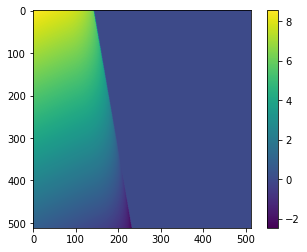

In [18]:
plt.imshow(images[5])
plt.colorbar()

In [16]:
from sharpf.utils.mesh_utils.io import trimesh_load
from sharpf.data.abc.abc_data import ABC7ZFile
import yaml

abc_obj = ABC7ZFile('/gpfs/gpfs0/3ddl/datasets/abc/abc_0001_obj_v00.7z')
abc_obj = abc_obj.get(str(id_[1].decode("utf-8")))

mesh = trimesh_load(abc_obj.obj)


In [35]:
filename = 'abc_0001_4330_4340.hdf5'
chunk = filename.split('_')[1]

'0001'

In [34]:
names = []
with open('/gpfs/gpfs0/3ddl/sharp_features/data/0001.txt', 'r') as f:
    lines = f.readlines() 
    for l in lines:
        names.append('_'.join(l.split(' ')[-1].split('/')[-1][:-5].split('_')[:-2]))
    
print(names.index('_'.join(id_[0].decode("utf-8").split('_')[:-1])))

4093


In [33]:
'_'.join(id_[0].decode("utf-8").split('_')[:-1])

'00015860_04d38329975c4a80ad73fe27'

In [32]:
'_'.join(names[0].split('_')[:-2])

'00010085_df3813ab6587454f8b8ccbc1'

In [25]:
[f.readline().split(' ')[-1].split('/')[-1][:-5],
 f.readline().split(' ')[-1].split('/')[-1][:-5]].index(id_[0].decode("utf-8"))

ValueError: '00015860_04d38329975c4a80ad73fe27_000' is not in list

In [8]:
id_[0].decode("utf-8")

'00015860_04d38329975c4a80ad73fe27_000'

In [17]:
abc_feat = ABC7ZFile('/gpfs/gpfs0/3ddl/datasets/abc/abc_0001_feat_v00.7z')
abc_feat = abc_feat.get(str(id_[1].decode("utf-8")))

features = yaml.load(abc_feat.feat, Loader=yaml.Loader)

In [80]:
import k3d 
def illustrate(mesh):
    plot = k3d.plot()

    point = k3d.mesh(mesh.vertices, mesh.vertex_faces)
    plot += point

    plot.display()

In [82]:
mesh

<trimesh.Trimesh(vertices.shape=(234723, 3), faces.shape=(469486, 3))>

In [2]:
import k3d
import numpy as np

Nx, Ny  = 34, 33
xmin, xmax = -3, 4
ymin, ymax = -0, 3

x = np.linspace(xmin, xmax, Nx)
y = np.linspace(ymin, ymax, Ny)
x, y = np.meshgrid(x, y)
f = np.sin(x**2 + y**2)

plot = k3d.plot()
plt_surface = k3d.surface(f.astype(np.float32), bounds=[xmin,xmax,ymin,ymax])
plot += plt_surface
plot.display()


Output()

In [4]:
plot = k3d.plot()
#plot += k3d.mesh(mesh.vertices, mesh.vertex_faces, opacity=1, color=0xffffff )
plot.display()

Output()

In [6]:
dataset_size = len(dataset)
indices = list(range(dataset_size))
validation_split = 0.2
split = int(np.floor(validation_split * dataset_size))

train_indices, val_indices = indices[split:], indices[:split]

train_sampler = SequentialSampler([50000])
valid_sampler = SequentialSampler([0, 1])

train_loader = DataLoader(dataset, batch_size=1, sampler=train_sampler)
val_loader = DataLoader(dataset, batch_size=1, sampler=valid_sampler)

In [6]:
import json
seg_cfg = json.load(open('/trinity/home/g.bobrovskih/sharp_features/sharpf/models/specs/regression_model.json'))

In [7]:
from seg_models_lib.segmentation_models_pytorch.unet import Classifier, Unet

model = Unet(
        encoder_name=seg_cfg['encoder'],
        encoder_weights=None,
        classes=len(seg_cfg['classes']),
        activation=seg_cfg['activation']
    )

/gpfs/data/home/g.bobrovskih/sharp_features/scripts/train_scripts/seg_models_lib/segmentation_models_pytorch/encoders/pd_vgg.py:74: UserWarning: nn.init.kaiming_normal is now deprecated in favor of nn.init.kaiming_normal_.
  nn.init.kaiming_normal(m.weight, mode='fan_out', nonlinearity='relu')
/gpfs/data/home/g.bobrovskih/sharp_features/scripts/train_scripts/seg_models_lib/segmentation_models_pytorch/encoders/pd_vgg.py:76: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  nn.init.constant(m.bias, 0)
/gpfs/data/home/g.bobrovskih/sharp_features/scripts/train_scripts/seg_models_lib/segmentation_models_pytorch/encoders/pd_vgg.py:78: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  nn.init.constant(m.weight, 1)
/gpfs/data/home/g.bobrovskih/sharp_features/scripts/train_scripts/seg_models_lib/segmentation_models_pytorch/encoders/pd_vgg.py:79: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  nn.init.

In [8]:
model.load_state_dict(torch.load('/gpfs/gpfs0/g.bobrovskih/high_res_3/seg_model_reg_unet_vgg16_bn_partconv_epoch_11'))

<All keys matched successfully>

In [7]:
def illustrate_3pic(pic1, pic2, pic3, name1, name2, name3):
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 15))
    im1 = ax1.imshow(pic1)
    ax1.set_title(name1)

    divider = make_axes_locatable(ax1)
    cax = divider.append_axes("right", size="5%", pad=0.07)

    fig.colorbar(im1, ax=ax1, cax=cax)
    im2 = ax2.imshow(pic2)
    ax2.set_title(name2)

    divider = make_axes_locatable(ax2)
    cax = divider.append_axes("right", size="5%", pad=0.07)

    fig.colorbar(im2, ax=ax2, cax=cax)
    im3 = ax3.imshow(pic3)
    ax3.set_title(name3)

    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.07)

    fig.colorbar(im3, ax=ax3, cax=cax)


In [8]:
count = 0
batch_in = []
for i in train_indices:
    print(i)
    batch = dataset[i]
#     depth = batch_in[0]
    target = batch[1]# + batch[1][1]*2
    if len(np.unique(target)) > 1: 
        count += 1
        batch_in.append(batch)
    if count == 10:
        break

11162
filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_1850_1860.hdf5
11163
11164
11165
11166
11167
11168
11169
11170
11171
11172
11173
filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_1850_1860.hdf5
11174
filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_1850_1860.hdf5
11175
filename /gpfs/data/gpfs0/3ddl/sharp_features/eccv_data/images/dataset_config_high_res_clean.json/01/abc_0001_1850_1860.hdf5


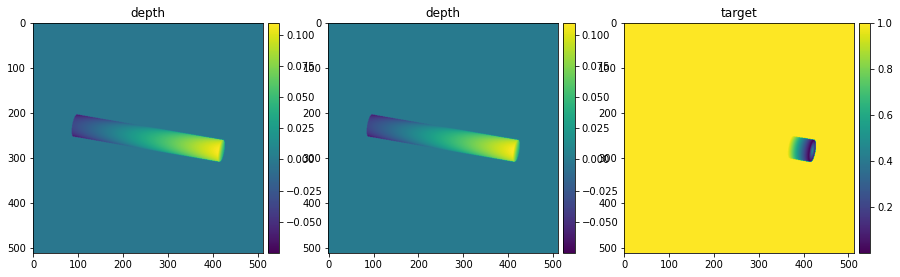

In [10]:
idx = 0
#batch = dataset[val_indices[0]]
depth = batch_in[idx][0]
target = batch_in[idx][1]#[0] + batch_in[idx][1][1]*2
illustrate_3pic(depth[0], depth[0]*depth[-1], target, 'depth', 'depth', 'target')

In [27]:
pred= model.predict(torch.FloatTensor(depth).unsqueeze(0))

In [28]:
prediction = pred[0][0]#pred[0][0] + pred[0][1]*2

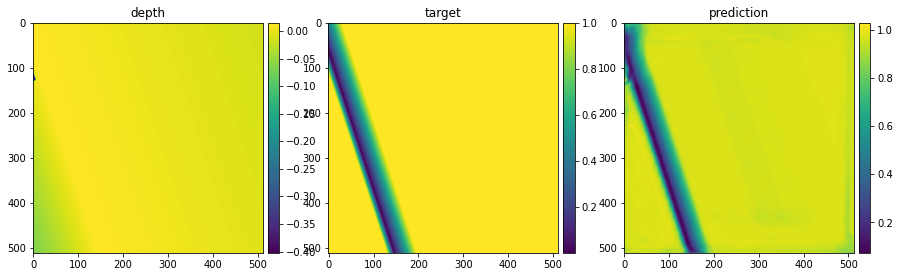

In [29]:
illustrate_3pic(depth[0]*depth[-1], target, prediction, 'depth', 'target', 'prediction')

In [15]:
depth[-1]

tensor([[1., 1., 1.,  ..., 1., 1., 1.],
        [1., 1., 1.,  ..., 1., 1., 1.],
        [1., 1., 1.,  ..., 1., 1., 1.],
        ...,
        [1., 1., 1.,  ..., 1., 1., 1.],
        [1., 1., 1.,  ..., 1., 1., 1.],
        [1., 1., 1.,  ..., 1., 1., 1.]])

In [28]:
np.unique(target)

array([1.], dtype=float32)

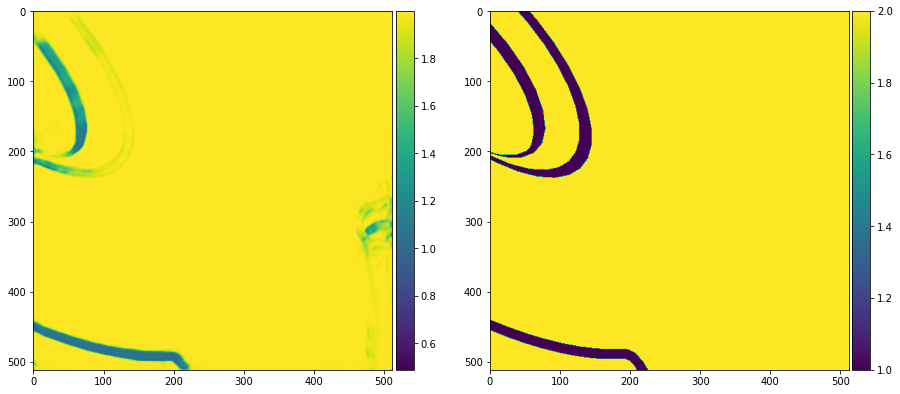

In [52]:
illustrate_2pic(prediction, target)

In [ ]:
def iou_pytorch(outputs: torch.Tensor, labels: torch.Tensor):
    # You can comment out this line if you are passing tensors of equal shape
    # But if you are passing output from UNet or something it will most probably
    # be with the BATCH x 1 x H x W shape
    outputs = outputs.squeeze(1)  # BATCH x 1 x H x W => BATCH x H x W
    
    intersection = (labels).float().sum((1, 2))  # Will be zero if Truth=0 or Prediction=0
    union = (outputs | labels).float().sum((1, 2))         # Will be zzero if both are 0
    
    iou = (intersection + SMOOTH) / (union + SMOOTH)  # We smooth our devision to avoid 0/0
    
    thresholded = torch.clamp(20 * (iou - 0.5), 0, 10).ceil() / 10  # This is equal to comparing with thresolds
    
    return thresholded  # Or thresholded.mean() if you are interested in average across the batch
    